In [1]:
%reload_ext autoreload
%autoreload 2

import sys
import numpy as np
np.set_printoptions(precision=4, suppress=True)
KITTI_ROOT_PATH = '/home/ruizhu/Documents/Datasets/kitti'
KITTI_PATH = KITTI_ROOT_PATH + '/raw'

sys.path.append(KITTI_ROOT_PATH+'/kitti-lidar-utils')
sys.path.append(KITTI_ROOT_PATH+'/kitti-lidar-utils/source')
sys.path.append(KITTI_ROOT_PATH+'/depth/devkit/python')
import itertools
import pdb
import pykitti  # install using pip install pykitti
import os
from PIL import Image, ImageOps
import imageio
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import time
from source.utils import load_tracklets_for_frames, point_inside, in_hull
from source import parseTrackletXML as xmlParser
from source.kitti_util import *
import argparse
from matplotlib import cm
# from cluster_pcs.filters import *
from math import atan2, degrees
from PIL import Image
from read_depth import *
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

import torch

## Select sequence
date_name = '2011_09_26'
seq_name = '_drive_0005_sync'
tracklet_path = KITTI_PATH+'/%s/%s/tracklet_labels.xml'%(date_name, date_name+seq_name)
fdir_path = KITTI_PATH+'/%s/%s/'%(date_name, date_name+seq_name)
if os.path.exists(tracklet_path):
    print('======Tracklet Exists:', tracklet_path)
else:
    print('======Tracklet NOT Exists:', tracklet_path)
    
## Raw Data directory information
path = fdir_path.rstrip('/')
basedir = path.rsplit('/',2)[0]
date = path.split('/')[-2]
drive = path.split('/')[-1].split('_')[-2]

dataset = pykitti.raw(basedir, date, drive)
tracklet_rects, tracklet_types, tracklet_ids, tracklet_Rs, tracklet_ts = load_tracklets_for_frames(len(list(dataset.velo)),\
               '{}/{}/{}_drive_{}_sync/tracklet_labels.xml'.format(basedir,date, date, drive)) # (3, 3) (3,)
dataset_gray = list(dataset.gray)
dataset_rgb = list(dataset.rgb) 

## From Rui
# Understanding calibs: https://github.com/utiasSTARS/pykitti/blob/0e5fd7fefa7cd10bbdfb5bd131bb58481d481116/pykitti/raw.py#L150
cam = 'leftRGB'
P_rects = {'leftRGB':dataset.calib.P_rect_20, 'rightRGB':dataset.calib.P_rect_30} # cameras def.: https://github.com/utiasSTARS/pykitti/blob/19d29b665ac4787a10306bbbbf8831181b38eb38/pykitti/odometry.py#L42
cam2cam = {}
R_cam2rect = dataset.calib.R_rect_00 # [cam0] R_rect_xx: 3x3 rectifying rotation to make image planes co-planar
P_rect = P_rects['leftRGB'] # P_rect_0[0-3]: 3x4 projection matrix after rectification; the reprojection matrix in MV3D
velo2cam = dataset.calib.T_cam0_velo_unrect
P_velo2im = np.dot(np.dot(P_rect, R_cam2rect), velo2cam) # 4*3

## Help functions and plot params
fig_scale = 300
fig_ratio = [4, 3]
im_shape = [375, 1242]

# https://github.com/vcg-uvic/learned-correspondence-release/blob/16bef8a0293c042c0bd42f067d7597b8e84ef51a/network.py#L160

%reload_ext autoreload
%autoreload 2
import dsac_tools.utils_F as utils_F
import dsac_tools.utils_geo as utils_geo
import dsac_tools.utils_misc as utils_misc
import dsac_tools.utils_vis as utils_vis

======Tracklet Exists: /home/ruizhu/Documents/Datasets/kitti/raw/2011_09_26/2011_09_26_drive_0005_sync/tracklet_labels.xml
Parsing tracklet file /home/ruizhu/Documents/Datasets/kitti/raw/2011_09_26/2011_09_26_drive_0005_sync/tracklet_labels.xml
File contains 15 tracklets
Loaded 15 tracklets.


In [2]:
%reload_ext autoreload
%autoreload 2
from kitti_tools.kitti_raw_loader import *

import glob
drive = KITTI_PATH+'/%s/%s'%(date_name, date_name+seq_name)
oxts_path = drive+'/oxts/data/*.txt'
oxts = sorted(glob.glob(oxts_path))
# print(oxts)

scene_data = {'cid': '', 'dir': drive, 'speed': [], 'frame_id': [], 'pose':[], 'rel_path': ''}
scale = None
origin = None
imu2velo_dict = read_calib_file(drive+'/../calib_imu_to_velo.txt')
velo2cam_dict = read_calib_file(drive+'/../calib_velo_to_cam.txt')
cam2cam_dict = read_calib_file(drive+'/../calib_cam_to_cam.txt')

velo2cam_mat = transform_from_rot_trans(velo2cam_dict['R'], velo2cam_dict['T'])
imu2velo_mat = transform_from_rot_trans(imu2velo_dict['R'], imu2velo_dict['T'])
cam_2rect_mat = transform_from_rot_trans(cam2cam_dict['R_rect_00'], np.zeros(3))

imu2cam = cam_2rect_mat @ velo2cam_mat @ imu2velo_mat
for n, f in enumerate(oxts):
    metadata = np.genfromtxt(f)
    speed = metadata[8:11]
    scene_data['speed'].append(speed)
    scene_data['frame_id'].append('{:010d}'.format(n))
    lat = metadata[0]

    if scale is None:
        scale = np.cos(lat * np.pi / 180.)

    pose_matrix = pose_from_oxts_packet(metadata[:6], scale)
    if origin is None:
        origin = pose_matrix

    odo_pose = imu2cam @ np.linalg.inv(origin) @ pose_matrix @ np.linalg.inv(imu2cam)
    odo_pose_Rt = odo_pose[:3]
    R21 = odo_pose_Rt[:, :3]
    t21 = odo_pose_Rt[:, 3:4]
    R12 = R21.T
    t12 = -np.matmul(R12, t21)
    Rt12 = np.hstack((R12, t12))
    scene_data['pose'].append(Rt12)
    
print(scene_data['pose'][:2])

[array([[ 1., -0.,  0., -0.],
       [ 0.,  1., -0.,  0.],
       [ 0., -0.,  1.,  0.]]), array([[ 0.9999,  0.0005,  0.0157,  0.0088],
       [-0.0005,  1.    , -0.0046,  0.0056],
       [-0.0157,  0.0046,  0.9999, -0.3428]])]


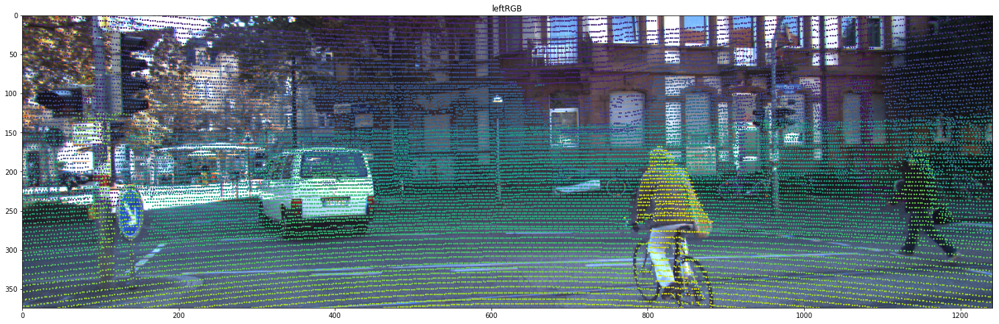

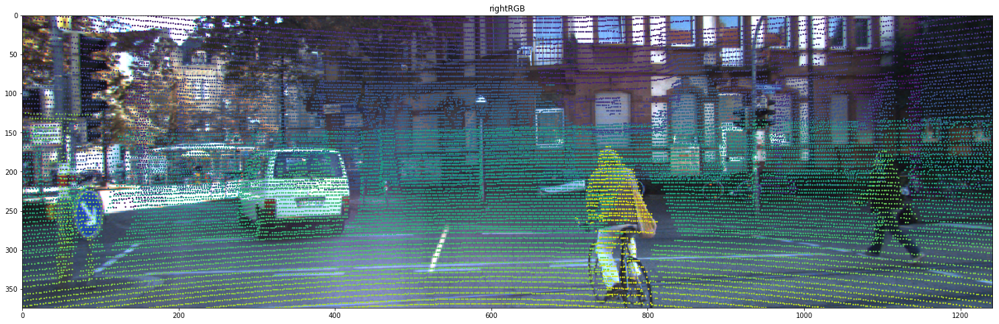

In [3]:
N_frames = len(list(dataset.velo))
velo_reproj_list = []
for i in range(N_frames):
    velo = list(dataset.velo)[i] # [N, 4]
    # project the points to the camera
    velo = velo[:, :3]
    velo_reproj = utils_misc.homo_np(velo)
    velo_reproj_list.append(velo_reproj)

    for cam_iter, cam in enumerate(['leftRGB', 'rightRGB']):
        P_rect = P_rects[cam] # P_rect_0[0-3]: 3x4 projection matrix after rectification; the reprojection matrix in MV3D
        P_velo2im = np.dot(np.dot(P_rect, R_cam2rect), velo2cam) # 4*3

        velo_pts_im = np.dot(P_velo2im, velo_reproj.T).T # [*, 3]
        velo_pts_im[:, :2] = velo_pts_im[:,:2] / velo_pts_im[:,2][..., np.newaxis]

        # check if in bounds
        # use minus 1 to get the exact same value as KITTI matlab code
        velo_pts_im[:, 0] = np.round(velo_pts_im[:,0]) - 1
        velo_pts_im[:, 1] = np.round(velo_pts_im[:,1]) - 1
        val_inds = (velo_pts_im[:, 0] >= 0) & (velo_pts_im[:, 1] >= 0)
        val_inds = val_inds & (velo_pts_im[:,0] < im_shape[1]) & (velo_pts_im[:,1] < im_shape[0])
        velo_pts_im = velo_pts_im[val_inds, :]
        
        if i == 0:
            plt.figure(figsize=(30, 8))
            plt.imshow(dataset_rgb[i][cam_iter])
            plt.scatter(velo_pts_im[:, 0].astype(np.int), velo_pts_im[:, 1].astype(np.int), s=2, c=1./velo_pts_im[:, 2])
            plt.xlim(0, im_shape[1]-1)
            plt.ylim(im_shape[0]-1, 0)
            plt.title(cam)
            plt.show()

# I_t and I_{t+1} setting
## Rectified cameras and points

[[721.5377   0.     609.5593  44.8573]
 [  0.     721.5377 172.854    0.2164]
 [  0.       0.       1.       0.0027]]
[[ 721.5377    0.      609.5593 -339.5242]
 [   0.      721.5377  172.854     2.1999]
 [   0.        0.        1.        0.0027]]
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]]
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]]
[[ 0.0598]
 [-0.0004]
 [ 0.0027]]
[[-0.4729]
 [ 0.0024]
 [ 0.0027]]
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]] [[-0.5327]
 [ 0.0028]
 [-0.    ]]


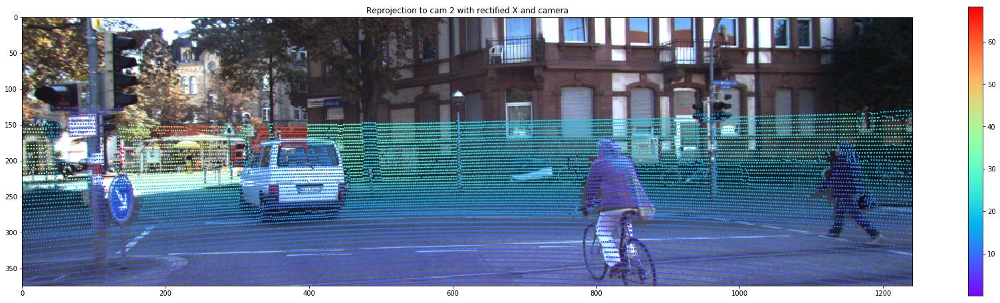

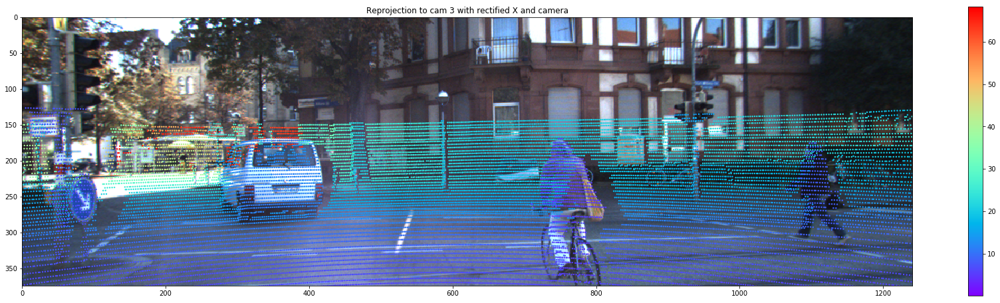

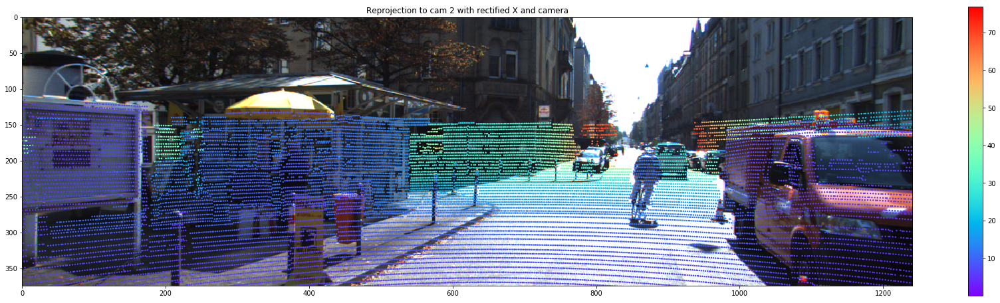

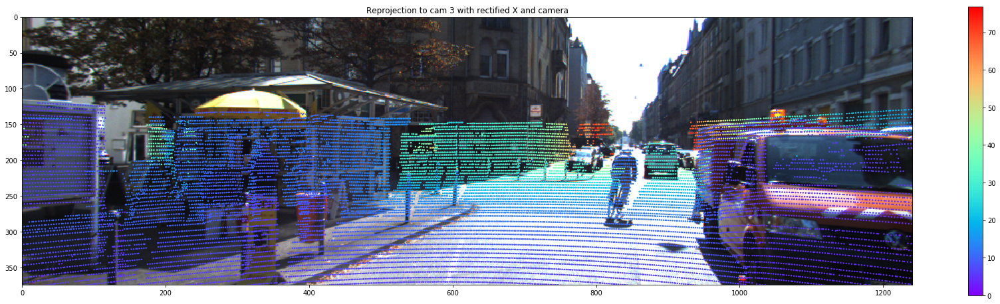

In [4]:
print(dataset.calib.P_rect_20)
print(dataset.calib.P_rect_30)
K = dataset.calib.P_rect_20[:3, :3]
K_th = torch.from_numpy(K)
M1_gt = np.matmul(np.linalg.inv(K), dataset.calib.P_rect_20)
M2_gt = np.matmul(np.linalg.inv(K), dataset.calib.P_rect_30)

t1_gt = M1_gt[:, 3:4]
t2_gt = M2_gt[:, 3:4]
R1_gt = M1_gt[:, :3]
R2_gt = M2_gt[:, :3]
print(R1_gt)
print(R2_gt)
print(t1_gt)
print(t2_gt)


R1t1_gt = np.vstack((np.hstack((R1_gt, t1_gt)), np.array([0., 0., 0., 1.], dtype=np.float64)))
delta_Rt_gt = np.matmul(np.hstack((R2_gt, t2_gt)), np.linalg.inv(R1t1_gt))
delta_R_gt = delta_Rt_gt[:, :3]
delta_t_gt = delta_Rt_gt[:, 3:4]
print(delta_R_gt, delta_t_gt)
t_gt_x = utils_misc._skew_symmetric(torch.from_numpy(delta_t_gt).float())
E_gt_th = torch.matmul(t_gt_x, torch.eye(3)).to(torch.float64)
F_gt_th = torch.matmul(torch.matmul(torch.inverse(K_th).t(), E_gt_th), torch.inverse(K_th))

def rectify(velo_reproj, im_l, im_r, visualize=False):
    val_inds_list = []

    X_homo = np.dot(np.dot(R_cam2rect, velo2cam), velo_reproj.T) # 4*N
    X_homo_rect = np.matmul(R1t1_gt, X_homo)
    X_rect = X_homo_rect[:3, :] / X_homo_rect[3:4, :]

    front_mask = X_rect[-1, :]>0
    X_rect = X_rect[:, front_mask]
    X_homo_rect = X_homo_rect[:, front_mask]

    # Plot with recfitied X and R, t
    x1_homo = np.matmul(K, np.matmul(np.hstack((np.eye(3), np.zeros((3, 1)))), X_homo_rect)).T
    x1 = x1_homo[:, 0:2]/x1_homo[:, 2:3]
    if visualize:
        plt.figure(figsize=(30, 8))
        plt.imshow(im_l)
        val_inds = utils_vis.scatter_xy(x1, x1_homo[:, 2], im_shape, 'Reprojection to cam 2 with rectified X and camera', new_figure=False)
    else:
        val_inds = utils_misc.within(x1[:, 0], x1[:, 1], im_shape[1], im_shape[0])
#     print(val_inds.shape)
    val_inds_list.append(val_inds)

    x2_homo = np.matmul(K, np.matmul(np.hstack((delta_R_gt, delta_t_gt)), X_homo_rect)).T
    x2 = x2_homo[:, :2]/x2_homo[:, 2:3]
    if visualize:
        plt.figure(figsize=(30, 8))
        plt.imshow(im_r)
        val_inds = utils_vis.scatter_xy(x2, x2_homo[:, 2], im_shape, 'Reprojection to cam 3 with rectified X and camera', new_figure=False)
    else:
        val_inds = utils_misc.within(x1[:, 0], x1[:, 1], im_shape[1], im_shape[0])
#     print(val_inds.shape)
    val_inds_list.append(val_inds)

    val_inds_both = val_inds_list[0] & val_inds_list[1]
#     print(val_inds_both.shape)
    val_idxes = [idx for idx in range(val_inds_both.shape[0]) if val_inds_both[idx]] # within indexes
    return val_idxes, X_rect

val_idxes_list = []
X_rect_list = []
for i in range(N_frames):
    val_idxes, X_rect = rectify(velo_reproj_list[i], dataset_rgb[i][0], dataset_rgb[i][1], visualize=(i%100==0))
    val_idxes_list.append(val_idxes)
    X_rect_list.append(X_rect)

## Test camera transformation matrixs

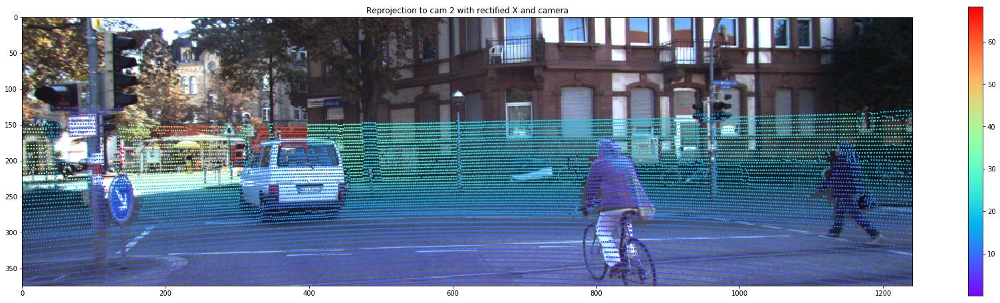

0.0
[[ 1. -0.  0. -0.]
 [ 0.  1. -0.  0.]
 [ 0. -0.  1.  0.]]


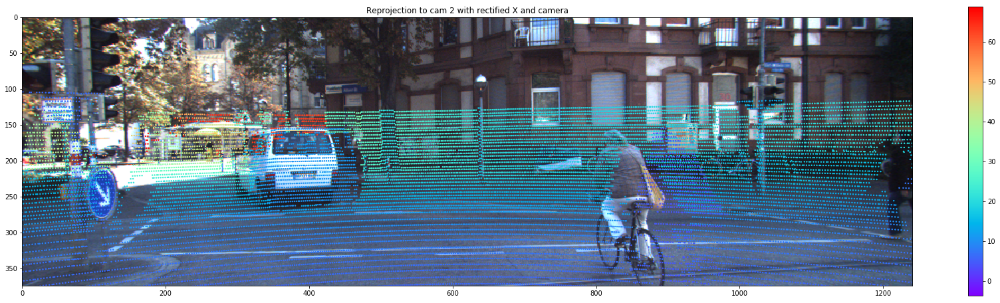

2.6813316336012916
[[ 0.9992 -0.0021  0.0404 -0.0269]
 [ 0.0031  0.9997 -0.0235  0.0465]
 [-0.0403  0.0236  0.9989 -0.9918]]


In [5]:
test_frame_idx = 3
Rt_gt_list = []
for i in [0, test_frame_idx]:
    X_rect = X_rect_list[0]
    Rt1 = scene_data['pose'][i]
    x1_homo = np.matmul(K, np.matmul(Rt1, utils_misc.homo_np(X_rect.T).T)).T
    x1 = x1_homo[:, 0:2]/x1_homo[:, 2:3]
    plt.figure(figsize=(30, 8))
    plt.imshow(dataset_rgb[i][0])
    val_inds = utils_vis.scatter_xy(x1, x1_homo[:, 2], im_shape, 'Reprojection to cam 2 with rectified X and camera', new_figure=False)
    print(utils_geo.rot12_to_angle_error(np.eye(3), Rt1[:, :3]))
    
    print(Rt1)
    Rt_gt_list.append(Rt1)

## Keypoint detection and matching with SIFT

# kps: 3420, descriptors: (3420, 128)
# kps: 3421, descriptors: (3421, 128)


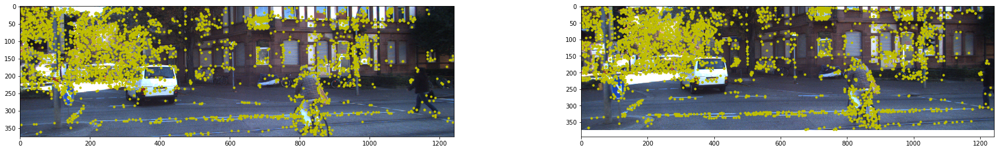

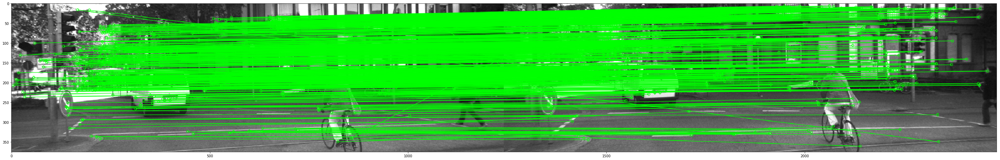

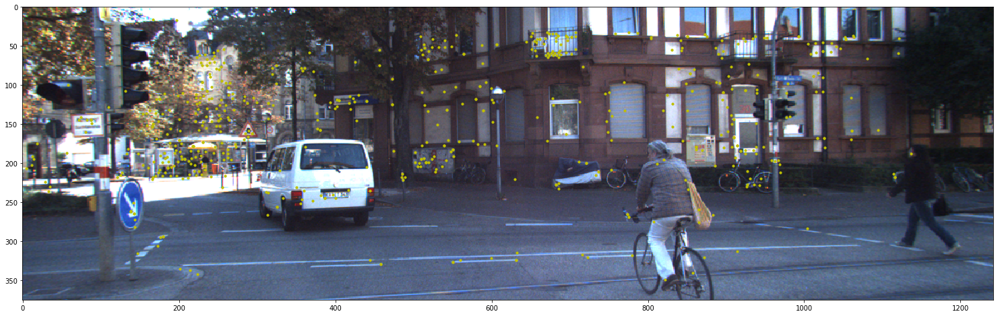

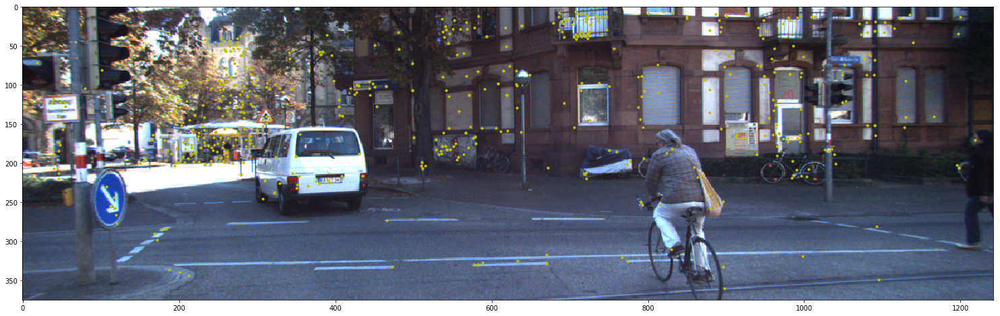

In [6]:
%reload_ext autoreload
%autoreload 2

import cv2
MIN_MATCH_COUNT = 10

img1_rgb = np.array(dataset_rgb[0][0])
img1 = cv2.cvtColor(img1_rgb, cv2.COLOR_BGR2GRAY)
img2_rgb = np.array(dataset_rgb[test_frame_idx][0])
img2 = cv2.cvtColor(img2_rgb, cv2.COLOR_BGR2GRAY)

# Initiate SIFT detector
# pip install opencv-python==3.4.2.16, opencv-contrib-python==3.4.2.16
# https://www.pyimagesearch.com/2015/07/16/where-did-sift-and-surf-go-in-opencv-3/
sift = cv2.xfeatures2d.SIFT_create()

# find the keypoints and descriptors with SIFT
kp1, des1 = sift.detectAndCompute(img1,None)
print("# kps: {}, descriptors: {}".format(len(kp1), des1.shape))
x1_all = np.array([p.pt for p in kp1])
# utils_vis.show_kp(img1_rgb, x1_all, 0.5)

kp2, des2 = sift.detectAndCompute(img2,None)
print("# kps: {}, descriptors: {}".format(len(kp2), des2.shape))
x2_all = np.array([p.pt for p in kp2])
# utils_vis.show_kp(img2_rgb, x2_all, 0.5)

plt.figure(figsize=(30, 4))
plt.subplot(121)
plt.imshow(img1_rgb)
plt.scatter(x1_all[:, 0], x1_all[:, 1], s=10, marker='o', c='y')
plt.subplot(122)
plt.imshow(img2_rgb)
plt.scatter(x2_all[:, 0], x2_all[:, 1], s=10, marker='o', c='y')
plt.show()

FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)

flann = cv2.FlannBasedMatcher(index_params, search_params)

matches = flann.knnMatch(des1,des2,k=2) # another option is https://github.com/MagicLeapResearch/SuperPointPretrainedNetwork/blob/master/demo_superpoint.py#L309
# store all the good matches as per Lowe's ratio test.
good = []
for m,n in matches:
    if m.distance < 0.7*n.distance:
        good.append(m)

draw_params = dict(matchColor = (0,255,0), # draw matches in green color
                   singlePointColor = None,
                   matchesMask = None, # draw only inliers
                   flags = 2)

img3 = cv2.drawMatches(img1,kp1,img2,kp2,good,None,**draw_params)

plt.figure(figsize=(60, 8))
plt.imshow(img3, 'gray')
plt.show()

x1 = x1_all[[mat.queryIdx for mat in good], :]
plt.figure(figsize=(30, 8))
plt.imshow(img1_rgb)
plt.scatter(x1[:, 0], x1[:, 1], s=10, marker='o', c='y')
plt.show()

x2 = x2_all[[mat.trainIdx for mat in good], :]
plt.figure(figsize=(30, 8))
plt.imshow(img2_rgb)
plt.scatter(x2[:, 0], x2[:, 1], s=10, marker='o', c='y')
plt.show()

assert x1.shape == x2.shape

## Plot epipolar constraint by OpenCV and Rui's implementations

[[ 0.0012  0.9926  0.0232]
 [-0.9921  0.0027 -0.0132]
 [-0.0466 -0.0268 -0.0012]]


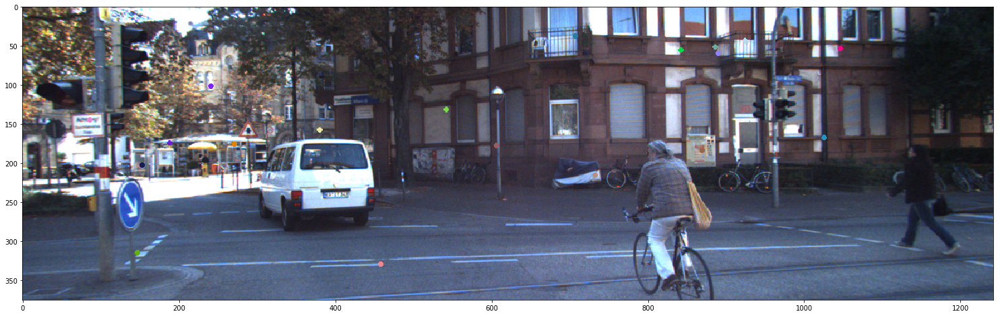

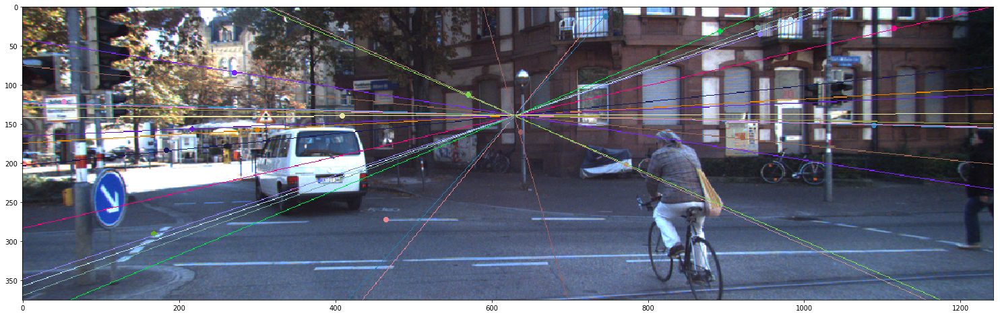

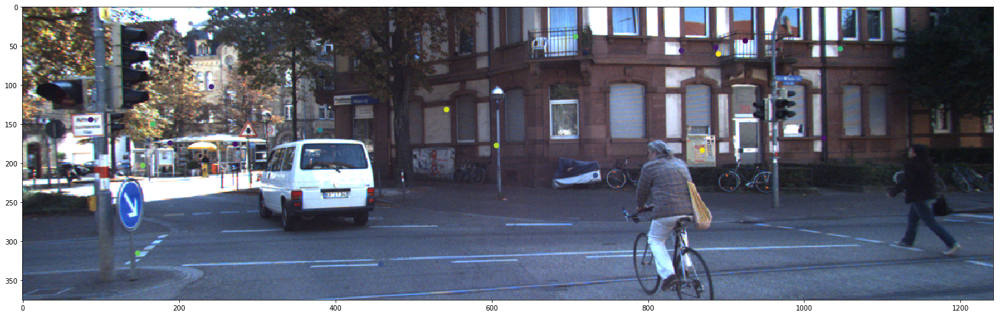

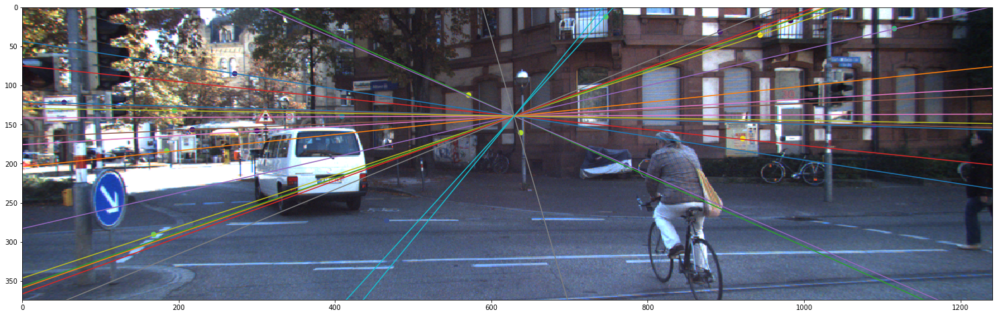

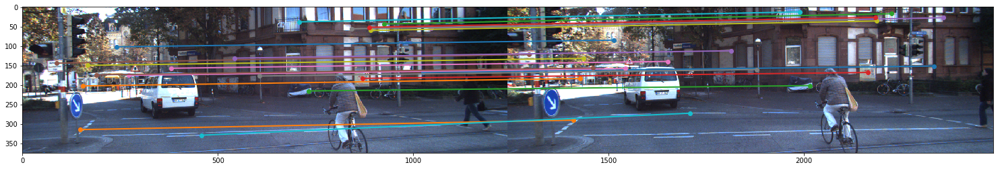

In [7]:
%reload_ext autoreload
%autoreload 2

E_gt_th, F_gt_th = utils_F._E_F_from_Rt(scene_data['pose'][test_frame_idx][:, :3], scene_data['pose'][test_frame_idx][:, 3:4], K)    
F_gt = F_gt_th.numpy()

R2s, t2s, M2s = utils_F._get_M2s(E_gt_th)
print(E_gt_th.numpy())
# print(scene_data['pose'][test_frame_idx][:, :3])
# print(R2s[0].numpy())
# print(scene_data['pose'][test_frame_idx][:, 3:4])
# print(t2s[0].numpy())

## By OpenCV
import dsac_tools.utils_vis as utils_vis

import random
random.seed(10)
N_points = 20
random_idx = random.sample(range(x1.shape[0]), N_points)
# random_idx = mask_index
x1_sample = x1[random_idx, :]
x2_sample = x2[random_idx, :]

lines2 = cv2.computeCorrespondEpilines(x1_sample.reshape(-1,1,2).astype(int), 1,F_gt)
lines2 = lines2.reshape(-1,3)
img3,img4 = utils_vis.drawlines(img2_rgb.copy(), img1_rgb.copy(), lines2, x2_sample.astype(int), x1_sample.astype(int))

plt.figure(figsize=(30, 8))
# plt.subplot(121),
plt.imshow(img4)
# plt.subplot(122),
plt.figure(figsize=(30, 8))
plt.imshow(img3)
plt.show()

## By Rui
x1_sample_homo = utils_misc.homo_np(x1_sample)
x2_sample_homo = utils_misc.homo_np(x2_sample)
right_P = np.matmul(F_gt, x1_sample_homo.T)
right_epipolar_x = np.tile(np.array([[0], [1]]), N_points) * im_shape[1]
# Using the eqn of line: ax+by+c=0; y = (-c-ax)/b, http://ai.stanford.edu/~mitul/cs223b/draw_epipolar.m
right_epipolar_y = (-right_P[2:3, :] - right_P[0:1, :] * right_epipolar_x) / right_P[1:2, :]

colors = np.random.rand(x2_sample.shape[0])
plt.figure(figsize=(30, 8))
# plt.subplot(121)
plt.imshow(img1_rgb)
plt.scatter(x1_sample[:, 0], x1_sample[:, 1], s=50, c=colors)
# plt.subplot(122)
plt.figure(figsize=(30, 8))
plt.imshow(img2_rgb)
plt.plot(right_epipolar_x, right_epipolar_y)
plt.scatter(x2_sample[:, 0], x2_sample[:, 1], s=50, c=colors)
plt.xlim(0, im_shape[1]-1)
plt.ylim(im_shape[0]-1, 0)
plt.show()

%reload_ext autoreload
%autoreload 2

from itertools import cycle
cycol = cycle('bgrcmk')
    
utils_vis.draw_corr(img1_rgb, img2_rgb, x1_sample, x2_sample, 2)

## Compute the Sampson distance
Multiplt View Geometry book, pg. 287, equ. 11.9, also https://github.com/marktao99/python/blob/master/CVP/samples/sfm.py#L216 ![image.png](https://ws3.sinaimg.cn/large/006tNc79ly1fzxju5m01oj3392070q4o.jpg)

[   0.2037   44.0133    0.9081    0.3166    0.1353    4.9955    0.0183
    0.1665    0.0247 1044.8554    0.0196    0.9512    0.0546    0.0029
    1.2065    0.0373    0.0588    1.1323    0.0564    0.5198]


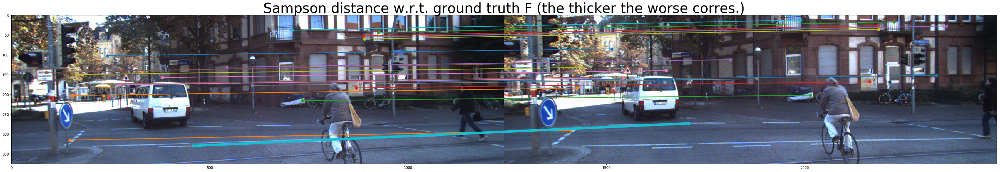

In [8]:
x1_sample_homo_th = torch.from_numpy(x1_sample_homo)
x2_sample_homo_th = torch.from_numpy(x2_sample_homo)
F_gt_th_scale = 0.01 * F_gt_th # to show this distance is invariant to scaling the F
nominator = (torch.diag(torch.matmul(torch.matmul(x2_sample_homo_th, F_gt_th_scale), x1_sample_homo_th.t())))**2
Fx1 = torch.mm(F_gt_th_scale, x1_sample_homo_th.t())
Fx2 = torch.mm(F_gt_th_scale, x2_sample_homo_th.t())
denom = Fx1[0]**2 + Fx1[1]**2 + Fx2[0]**2 + Fx2[1]**2
error = nominator/denom
print(error.numpy())

utils_vis.draw_corr_widths(img1_rgb, img2_rgb, x1_sample, x2_sample, error.numpy()/np.max(error.numpy())*5+2, 'Sampson distance w.r.t. ground truth F (the thicker the worse corres.)', False)

# DSAC

[0.     0.     0.     0.     0.     0.     0.0001 0.0001 0.0002 0.0003
 0.0003 0.0003 0.0004 0.0004 0.0004 0.0005 0.0006 0.0007 0.0007 0.0008]


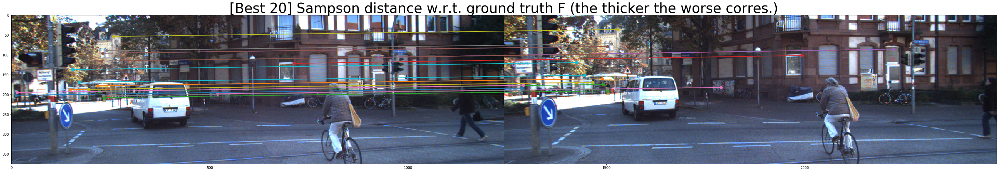

+++ [[-0.0014 -0.9937 -0.0209]
 [ 0.9906 -0.0056  0.0454]
 [ 0.044  -0.007   0.0019]]
[[ 0.0012  0.9926  0.0232]
 [-0.9921  0.0027 -0.0132]
 [-0.0466 -0.0268 -0.0012]]
--- [[-0.     -0.      0.0003]
 [ 0.     -0.     -0.0011]
 [-0.0003  0.0012 -0.0292]]
[[ 0.      0.     -0.0003]
 [-0.      0.      0.0011]
 [ 0.0003 -0.0012  0.0292]]


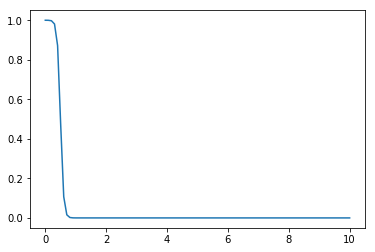

In [9]:
%reload_ext autoreload
%autoreload 2
np.set_printoptions(precision=4, suppress=True)

from dsac_tools.H_loss import HLoss
from dsac_tools.dsac import DSAC

from scipy.io import savemat

# Validation: use best 10 corres with smalles Sampson distance to GT F to compute E and F
errors = utils_F._sampson_dist(F_gt_th, torch.from_numpy(x1).to(torch.float64), torch.from_numpy(x2).to(torch.float64), False)
sort_index = np.argsort(errors.numpy())
mask_index = sort_index[:20]
print(errors[mask_index].numpy())

utils_vis.draw_corr_widths(img1_rgb, img2_rgb, x1[mask_index, :], x2[mask_index, :], np.zeros(x2[mask_index, :].shape[0])+2, '[Best 20] Sampson distance w.r.t. ground truth F (the thicker the worse corres.)', False)
E_est_th = utils_F._E_from_XY(torch.from_numpy(x1[mask_index, :]), torch.from_numpy(x2[mask_index, :]),K_th)
print('+++', (E_est_th / torch.norm(E_est_th) * torch.norm(E_gt_th)).numpy())
print(E_gt_th.numpy())

M2_list = utils_F._get_M2s(E_est_th)

F_est_th = utils_F._F_from_XY(torch.from_numpy(x1[mask_index, :]), torch.from_numpy(x2[mask_index, :]))
print('---', (F_est_th / torch.norm(F_est_th) * torch.norm(F_gt_th)).numpy())
print(F_gt)

inlier_beta = 20
inlier_thresh = 0.5 # HOW TO SET THRES?
a = torch.linspace(0, 10, 100)
b = 1 - torch.sigmoid(inlier_beta * (a - inlier_thresh))
plt.plot(a.numpy(), b.numpy())
plt.show()

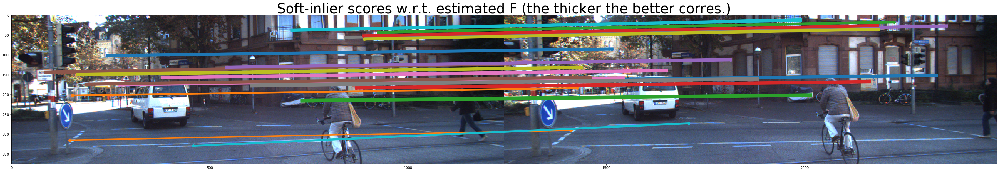

[[-0.     -0.      0.0003]
 [ 0.     -0.     -0.0011]
 [-0.0003  0.0011 -0.0292]]
[[ 0.      0.     -0.0003]
 [-0.      0.      0.0011]
 [ 0.0003 -0.0012  0.0292]]
[[-0.0022 -0.9929  0.0005]
 [ 0.9898 -0.0012  0.0764]
 [ 0.0224 -0.0375  0.0018]]
[[ 0.0012  0.9926  0.0232]
 [-0.9921  0.0027 -0.0132]
 [-0.0466 -0.0268 -0.0012]]


In [47]:
%reload_ext autoreload
%autoreload 2

from dsac_tools.H_loss import HLoss
from dsac_tools.dsac import DSAC
import dsac_tools.utils_F as utils_F
import torch

np.set_printoptions(precision=4, suppress=True)

N_hypotheses = 10000
inlierthreshold = 0.05
inlierbeta = 100.
inlieralpha = 0.5

loss = HLoss()
dsac = DSAC(N_hypotheses, inlierthreshold, inlierbeta, inlieralpha, loss)
N_scores = dsac(torch.from_numpy(x1), torch.from_numpy(x2), F_gt_th)
N_scores_np = N_scores.numpy()
N_scores_np = N_scores_np/np.max(N_scores_np)

utils_vis.draw_corr_widths(img1_rgb, img2_rgb, x1_sample, x2_sample, N_scores_np[random_idx]*10+1, 'Soft-inlier scores w.r.t. estimated F (the thicker the better corres.)', False)

F_est_th = dsac.best_H
best_corres_idx = dsac.best_corres_idx
print((F_est_th / torch.norm(F_est_th) * torch.norm(F_gt_th)).numpy())
print(F_gt)

E_est_th = utils_F._F_to_E(F_est_th, K_th)
print((E_est_th / torch.norm(E_est_th) * torch.norm(E_gt_th)).numpy())
print(E_gt_th.numpy())

In [74]:
%reload_ext autoreload
%autoreload 2

inlier_mask = dsac.sampson_dists.numpy()[best_H_idx, :] < inlier_thresh
M2_list = utils_F._E_to_M(E_est_th, K, x1, x2, inlier_mask, delta_R_gt)

[[ 0.9992 -0.0021  0.0393  0.0377]
 [ 0.0031  0.9997 -0.0232  0.0227]
 [-0.0392  0.0233  0.999  -0.999 ]]
[ 43.6153  41.7721  42.556   41.9441  15.9146  37.6095  38.3589  38.1619
  50.4599  52.5793  74.7053  40.1924  37.0098  38.1125  39.9455  37.9671
  37.1331  37.9878  38.0643  38.8427  38.8427  40.2609  41.2475  41.2569
  40.9149  41.0956  58.6917  40.2816  38.3279  42.62    42.132   42.132
  40.608   40.0957  42.5142  40.3519  41.5345  41.2958  42.8092  43.1658
  49.2389  49.2389  45.746   44.1643  61.1277  43.1861  45.8401  41.4676
  44.5922  42.8351  42.5568  46.3805  55.8078  55.0487  47.9585  47.9585
  60.1148  53.9831  49.4231  50.1038  48.4917  62.7155  39.9436  52.1645
  52.1645  59.104   41.0899  48.1539  40.3225  44.599   47.887   47.3127
  48.876   48.876   46.867   46.867   44.8428  44.3149  47.9001  76.6942
  61.7259  61.7259  55.7549  44.9567  58.0487  75.4539  56.6706  47.9916
  70.8563  43.2602  66.9527  74.4352  60.8705  56.704   45.9822  74.7918
  39.9574  41.5859 

# With SuperPoint corres.

In [79]:
sp_results = np.load('dsac_tools/data/0000000000.npz')
print(x.files)
x1_sp = sp_results['keypoints1']
x2_sp = sp_results['keypoints2']
maches_sp = sp_results['matches']
x1 = maches_sp[:, :2]
x2 = maches_sp[:, 2:4]
print(x1_sp.shape, x2_sp.shape, maches_sp.shape)
print(x1.shape, x2.shape)

draw_corr_widths(img1_rgb, img2_rgb, x1, x2, np.zeros(x1.shape[0])+3, 'SuperPoint detection and correspondence', rescale=False)

errors = utils_F._sampson_dist(F_gt_th, torch.from_numpy(x1).to(torch.float64), torch.from_numpy(x2).to(torch.float64), False)
sort_index = np.argsort(errors.numpy())
mask_index = sort_index[:10]
print(errors[sort_index].numpy())

E_est_th = utils_F.E_from_XY(torch.from_numpy(x1[mask_index, :]), torch.from_numpy(x2[mask_index, :]))
print(E_gt_th.numpy())
print((E_est_th / torch.norm(E_est_th) * torch.norm(E_gt_th)).numpy())
R2s, t2s, M2s = utils_F._get_M2s(E_est_th)
print(M2s[0].numpy())

error_R = min([utils_F.rot12_to_angle_error(R2.numpy(), delta_R_gt) for R2 in R2s])
print('The rotation error of best 10 corres. w.r.t GT F (degree): ', error_R)

NameError: name 'x' is not defined

In [ ]:
%reload_ext autoreload
%autoreload 2

from dsac_tools.H_loss import HLoss
from dsac_tools.dsac import DSAC
import dsac_tools.utils_F as utils_F
import torch

N_hypotheses = 10000
inlierthreshold = 0.05
inlierbeta = 100.
inlieralpha = 0.5

loss = HLoss()
dsac = DSAC(N_hypotheses, inlierthreshold, inlierbeta, inlieralpha, loss)
N_scores = dsac(torch.from_numpy(x1), torch.from_numpy(x2), F_gt_th)
N_scores_np = N_scores.numpy()
N_scores_np = N_scores_np/np.max(N_scores_np)

draw_corr_widths(img1_rgb, img2_rgb, x1, x2, N_scores_np*5, 'Soft-inlier scores w.r.t. estimated F (the thicker the better corres.)', False)

F_est_th = dsac.best_H
best_corres_idx = dsac.best_corres_idx
# print((F_est_th / torch.norm(F_est_th) * torch.norm(F_gt_th)).numpy())
# print(F_gt)

E_est_th = utils_F._F_to_E(F_est_th, K_th)
print((E_est_th / torch.norm(E_est_th) * torch.norm(E_gt_th)).numpy())
print(E_gt_th.numpy())

R2s, t2s, M2s = utils_F._get_M2s(E_est_th)
# print([M2.numpy() for M2 in M2s])

R1 = np.eye(3)
t1 = np.zeros((3, 1))
M1 = np.hstack((R1, t1))

cheirality_checks = []
for Rt_idx, M2 in enumerate(M2s):
    M2 = M2.numpy()
    R2 = M2[:, :3]
    t2 = M2[:, 3:4]
    
    X_tri_homo = cv2.triangulatePoints(np.matmul(K, M1), np.matmul(K, M2), x1[best_corres_idx, :].T, x2[best_corres_idx, :].T)
    X_tri = X_tri_homo[:3, :]/X_tri_homo[-1, :]
    cheirality1 = np.matmul(R1[2:3, :], (X_tri-t1))
    
    X_tri_cam3 = np.matmul(R2, X_tri) + t2
    cheirality2 = np.matmul(R2[2:3, :], (X_tri-t2))
    cheirality_checks.append(np.min(cheirality1)>0 and np.min(cheirality2)>0)
    
    print('===========')
    print(M2)
    print('-----')
    print(cheirality1)
    print('-----')
    print(cheirality2)

if np.sum(cheirality_checks)==1:
    Rt_idx = cheirality_checks.index(True)
    print('The %d_th Rt meets the Cheirality Condition! with [R|t]:'%Rt_idx)
    print(M2s[Rt_idx].numpy())
else:
    print('Error! %d of qualified [R|t] found!'%np.sum(cheirality_checks))

error_R = min([utils_F.rot12_to_angle_error(R2.numpy(), delta_R_gt) for R2 in R2s])
print('The rotation error from RANSAC (degree): ', error_R)